In [1]:
import os
import sys
from decimal import Decimal

module_path = os.path.abspath(os.path.join('../..'))
if module_path not in sys.path:
    sys.path.append(module_path)
from methods import main_methods as mm

import segmentation_gmm as seg_gmm
import segmentation_watershed as seg_water
import ssts_helpers as sh

import numpy as np
import pandas as pd
import scipy.stats as stats
import matplotlib.pyplot as plt

from collections import defaultdict

%matplotlib inline
# %load_ext autoreload
# %autoreload 2

In [2]:
qnm_fields = ['Adhesion', 'Deformation', 'Dissipation', 'Modulus', 'Height', 'Stiffness']

In [3]:
lit_files = '/Users/wesleytatum/Dropbox/SSTS_files/Manuscript/data_files/'

im1_0deg = np.load(lit_files+'P3HT-PCBM_150C_15min_0deg.npy')
im2_90deg = np.load(lit_files+'P3HT-PCBM_150C_15min_90deg.npy')
im3_annealed = np.load(lit_files+'P3HT-PCBM_150C_15min_sub2.npy')
im4_no_anneal = np.load(lit_files+'P3HT-PCBM_no-anneal.npy')
im5_PTB7 = np.load(lit_files+'PTB7PC71BM_CBonly_ascast_fresh_500 nm_combined.npy')
im6_OFET = np.load(lit_files+'150C_30min_8_3_combined.npy')
im7_NWs = np.load(lit_files+'100-0_72_NW_combined.npy')

ims = [im1_0deg, im2_90deg, im3_annealed, im4_no_anneal, im5_PTB7, im6_OFET, im7_NWs]

## Define iterable classification workflow

In [4]:
def ssts_pipeline(dataframe, heightless, n_components, padding, embedding_dim, nonlinear, plots):
    """
    Wrapper function for SSTS tools. Allows to include or exclude SSTS tools in the order shown in the code.
    
    Args:
    dataframe - np.array(). 3D array of SPM data
    heightless - bool. if 'True', height channel is removed. Height is assumed to be dataframe[:,:,4]
    n_components - int. number specifying the number of Gaussian phase distributions to be identified in dataframe
    padding - int. number specifying the degree of closeness of neighbors to be included in GMM labelling
    embedding_dims - int. number specifying the number of principle components to use in PCA before GMM labelling
    nonlinear - bool. if 'True', nonlinear properties are generated prior to analysis. Includes x^2, x^3, abs(x),
                and 1/x
                
    Returns:
    outliers - np.array(). 2D array of outliers
    seg1_labels - np.array(). 2D array of GMM labels
    seg2_labels - np.array(). 2D array of clustering labels
    """
    # Apply frequency removal
    data = mm.apply_frequency_removal(dataframe)

    # Extract outliers
    outliers = mm.extract_outliers(data)
    no_outliers_data = np.copy(data)
    no_outliers_data[outliers==1] = 0
    if plots == True:
        mm.show_outliers(data, outliers)
    else:
        pass

    if plots == True:
        # Show a-priori distributions
        mm.show_property_distributions(data, outliers)
    else:
        pass

    # Run GMM segmentation
    seg1 = seg_gmm.SegmenterGMM(n_components = n_components, embedding_dim = embedding_dim,
                                padding = padding, nonlinear = nonlinear)

    if heightless == True:
        # Remove height property
        no_height_data = np.delete(no_outliers_data, 4, axis=2)
        
        seg1_labels = seg1.fit_transform(no_height_data, outliers)
        if plots == True:
            mm.show_classification(seg1_labels, no_height_data)
            mm.show_distributions_together(seg1_labels, no_height_data)
        else:
            pass
        
        seg2_labels = seg1.get_grains(seg1_labels)
        if plots == True:
            mm.show_classification(seg2_labels, no_height_data)
        else:
            pass
        
    elif heightless == False:
        seg1_labels = seg1.fit_transform(no_outliers_data, outliers)
        if plots == True:
            mm.show_classification(seg1_labels, no_outliers_data)
            mm.show_distributions_together(seg1_labels, no_outliers_data)
        else:
            pass
        
        seg2_labels = seg1.get_grains(seg1_labels)
        if plots == True:
            mm.show_classification(seg2_labels, no_outliers_data)
        else:
            pass
        
    else:
        print ('Error: Heightless flag incorrect')
    
    return outliers, seg1_labels, seg2_labels

## Test iterable workflow on a single image

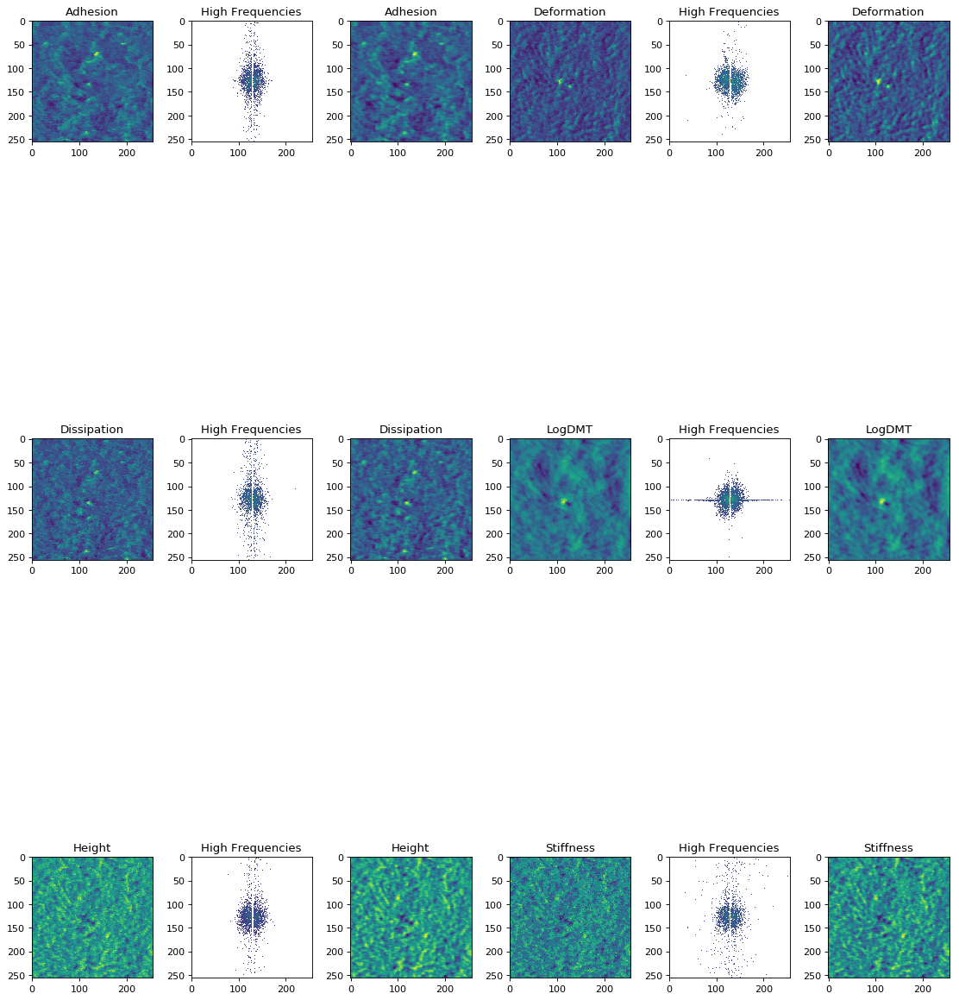

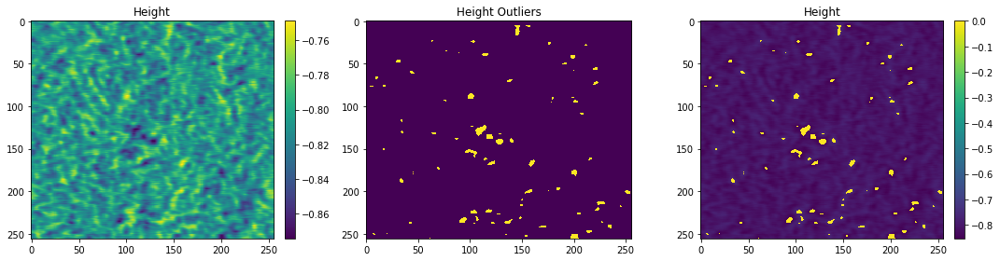

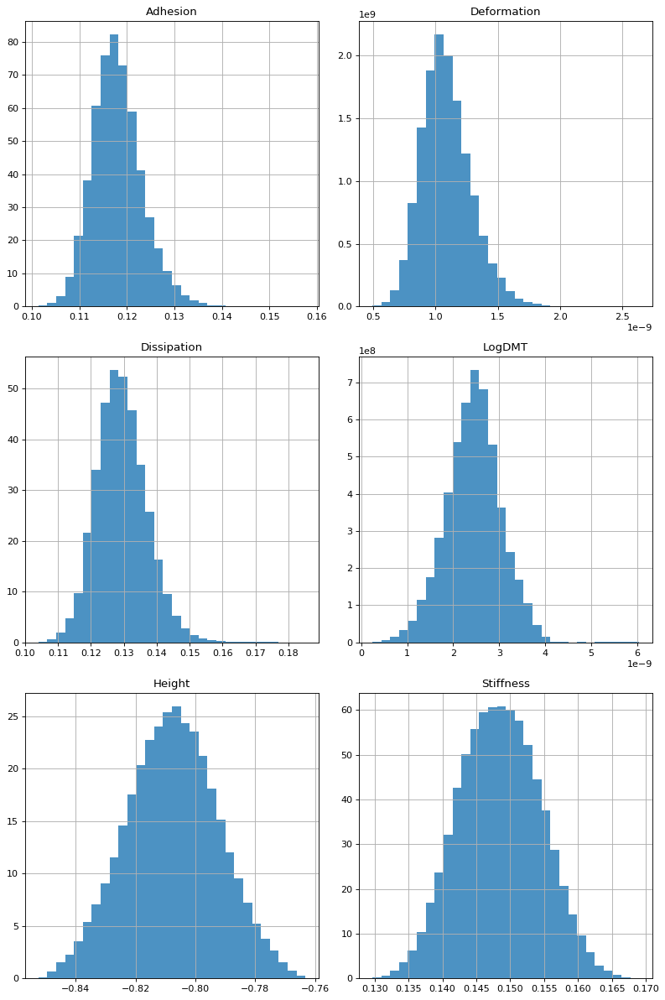

/Users/diegotorrejon/Projects/Other/SSTS/ssts/segmentation/segmentation_gmm.py:207: RuntimeWarning: divide by zero encountered in true_divide
  reciprocal_data = 1 / data


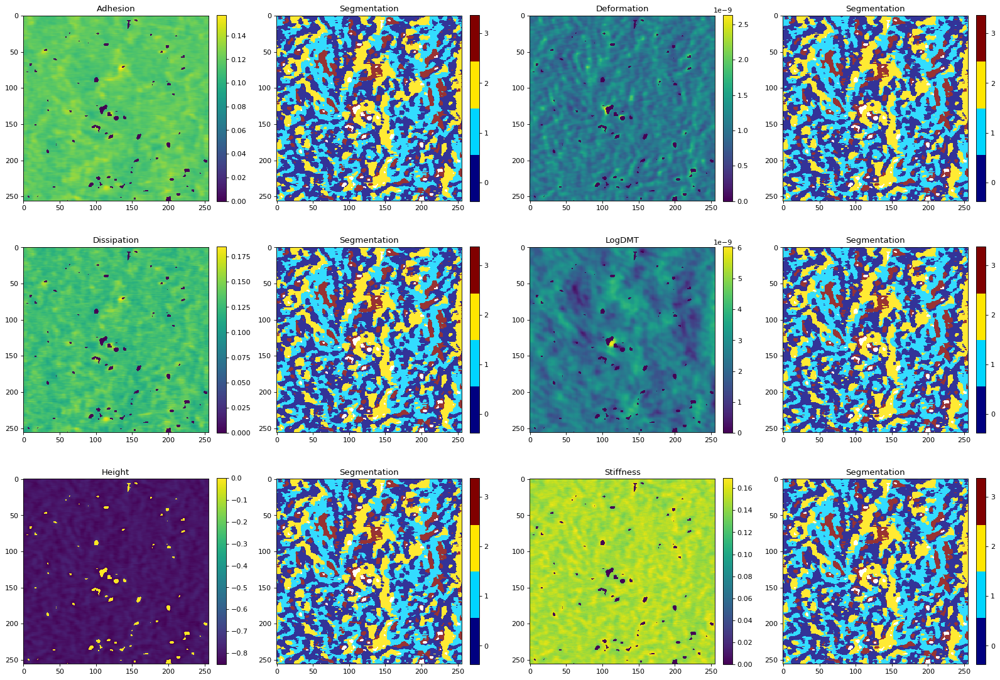

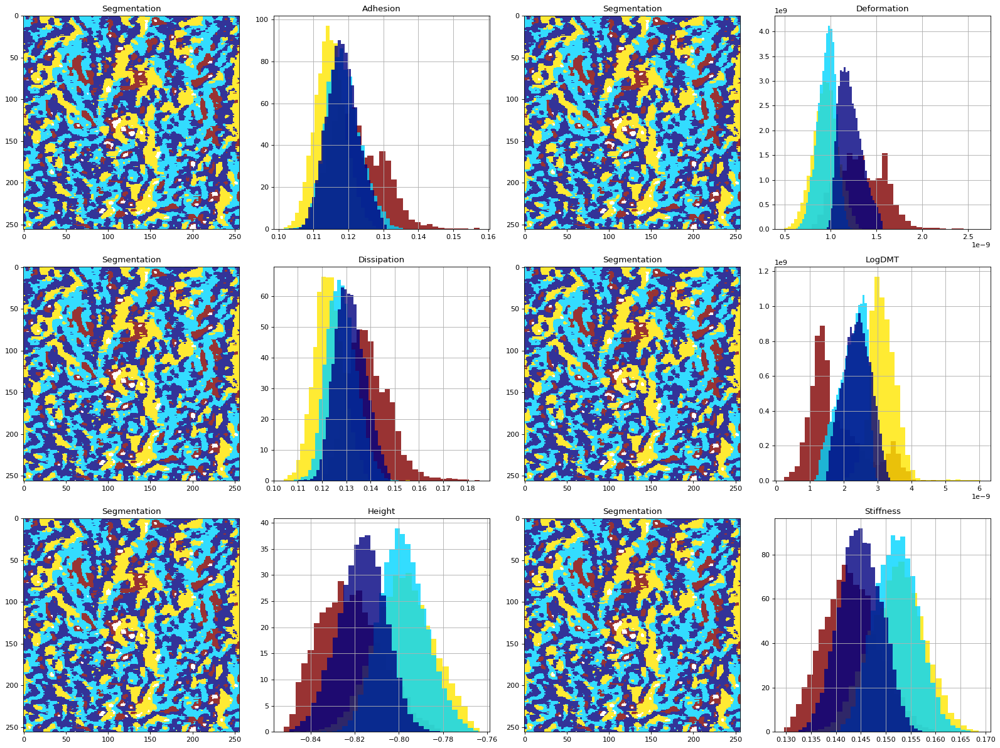

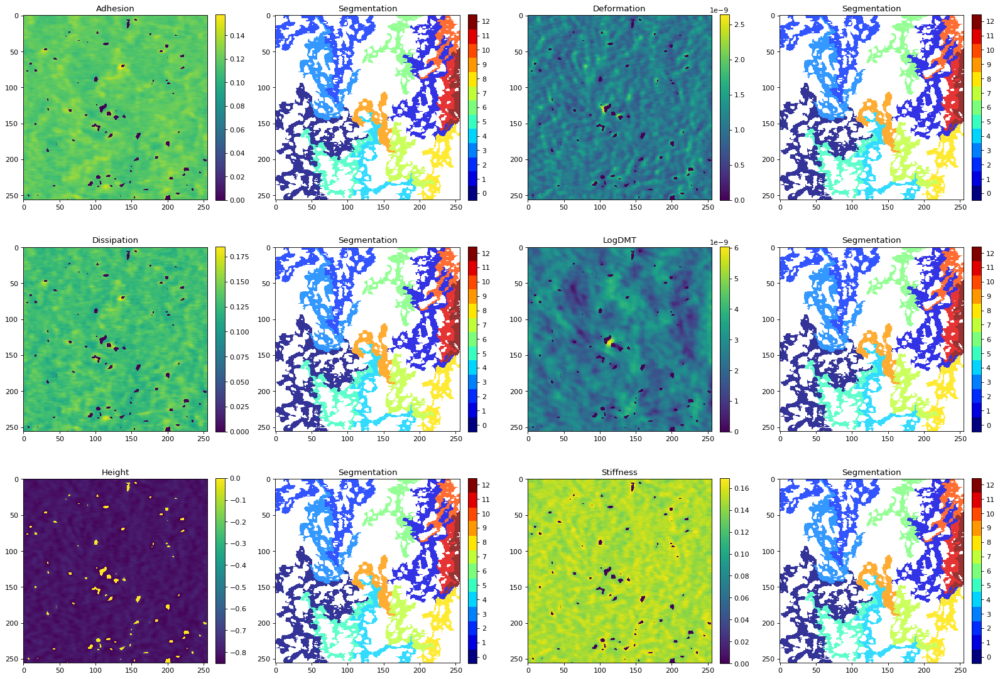

In [5]:
dataframe = ims[2]
heightless = False
n_components = 4
padding = 0
embedding_dim = None
nonlinear = True
plots = True

outliers, seg1_labels, seg2_labels = ssts_pipeline(dataframe, heightless = heightless, n_components = n_components,
                                                   padding = padding, embedding_dim = embedding_dim,
                                                   nonlinear = nonlinear, plots = plots)

In [6]:

def get_stats_dict(seg1_labels, dataframe):
    # {component: {property: stats}}
    
    labels = mm.get_unique_labels(seg1_labels)

    p_stats = defaultdict(dict)
    h, w, c = dataframe.shape
    for l in labels:
        for i in range(c):
            
            # First: dataframe[:,:,i] extracts out the ith property data, i.e., the (h x w) array
            # of pixels for the ith property.
            # Second: seg1_labels is a (h x w) array with entries being the different components.
            # Third: (seg1_labels == l) is a (h x w) array with entries being 0 or 1. It's 1 if the entries
            # match label l and 0 if they don't.
            # Finally: data[:,:,i][seg1_labels == l] extracts all the entries of the ith property data,
            # that match the lth component.
            data = dataframe[:,:,i][seg1_labels == l]
            p_stats[l][i] = [
                np.median(data), np.std(data), np.var(data)
            ]
        
    return p_stats
        
# p_stats = get_stats_dict(seg1_labels, dataframe)

## Apply workflow to single image and iterate, varying a single hyper parameter (num_components)

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


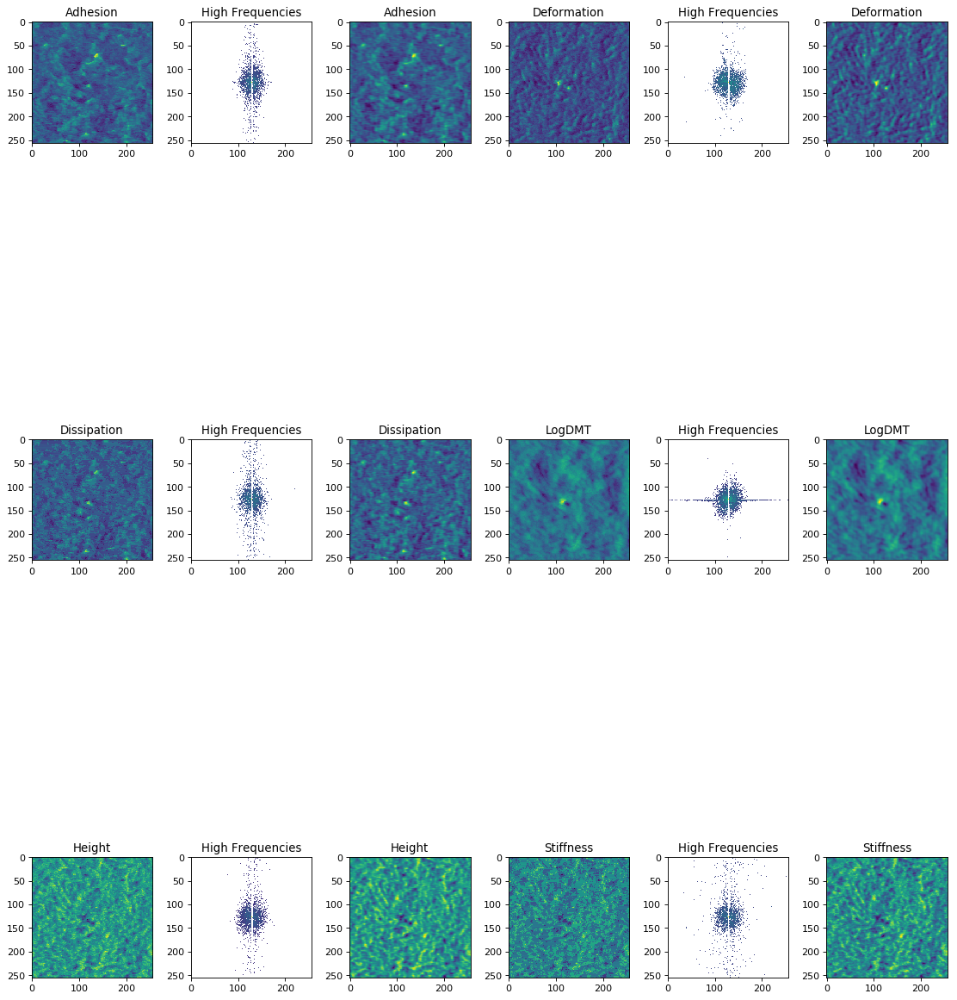

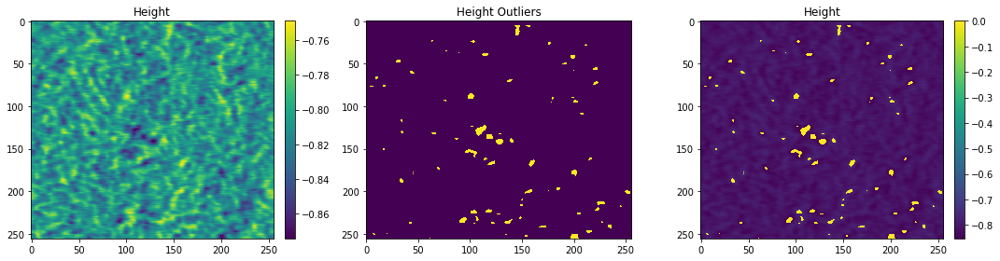

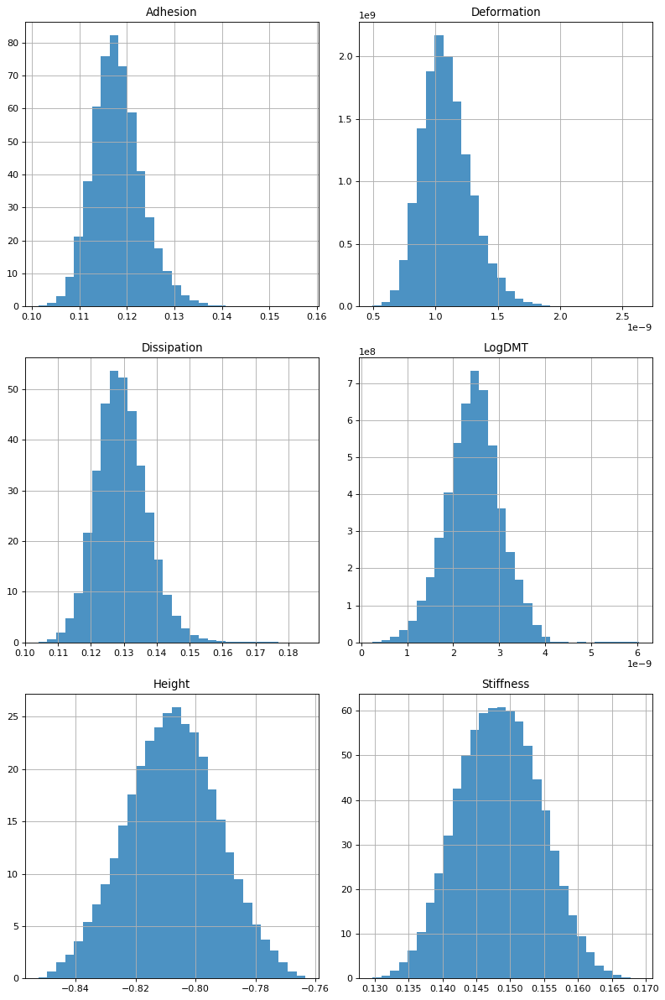

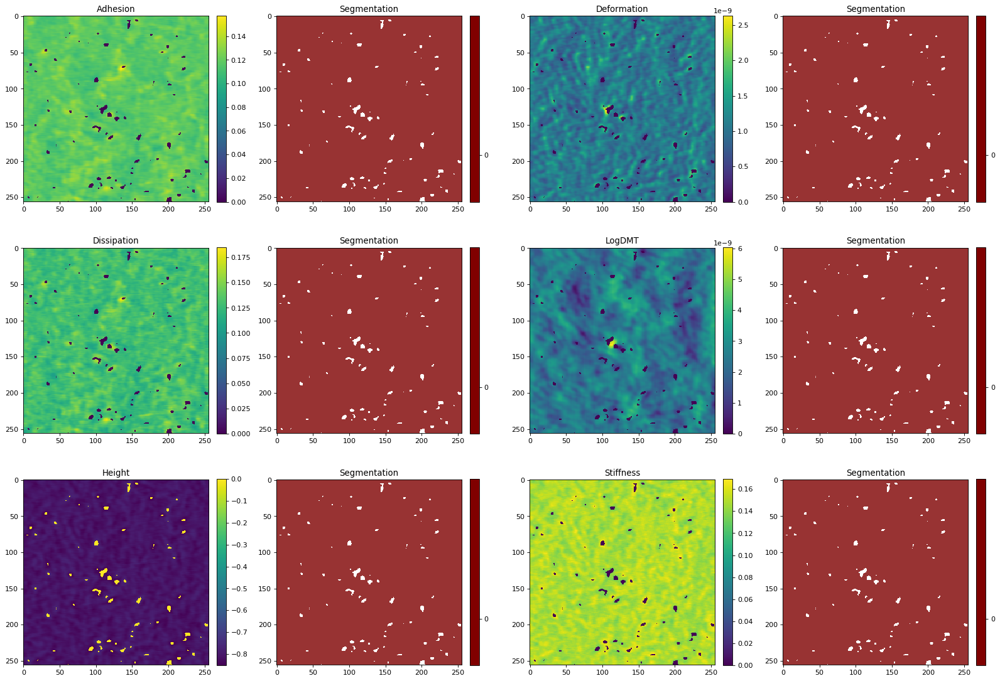

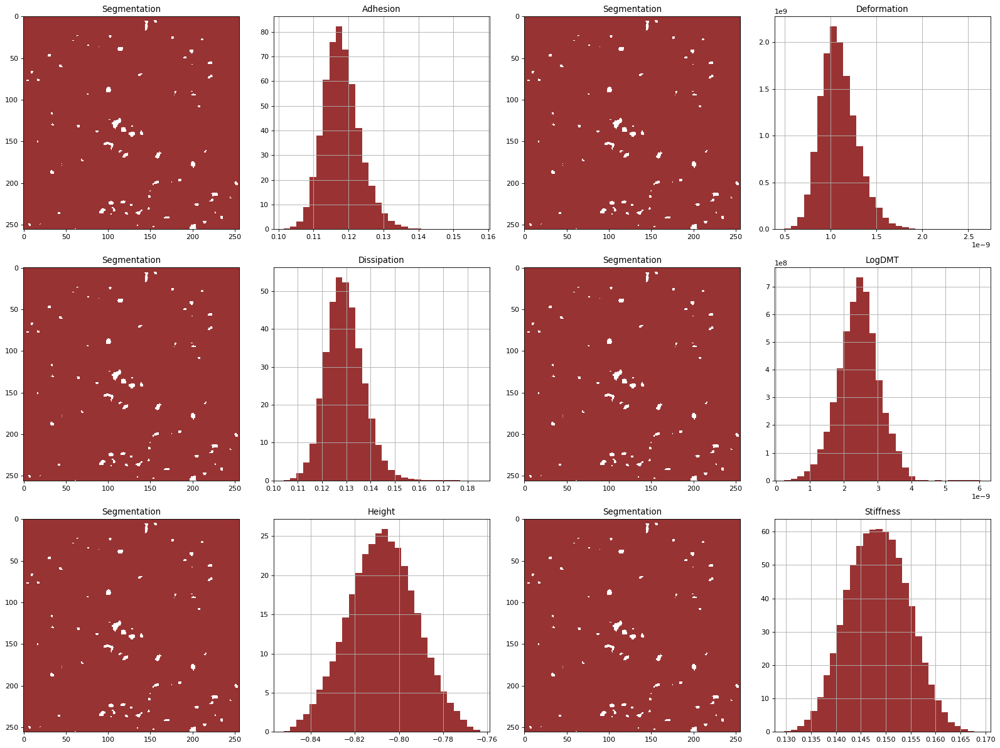

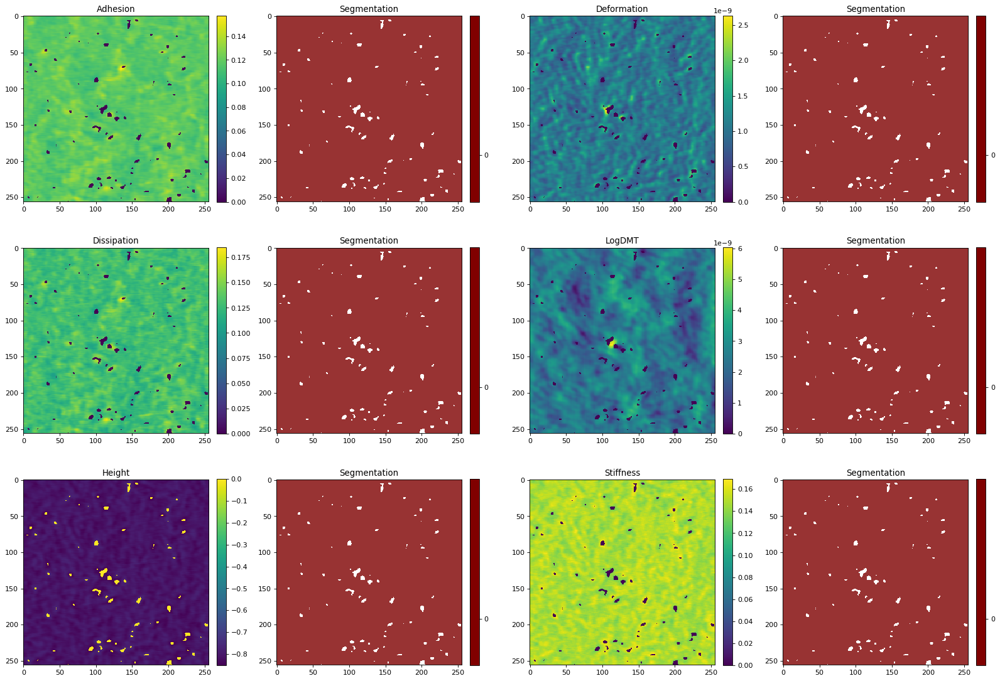

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


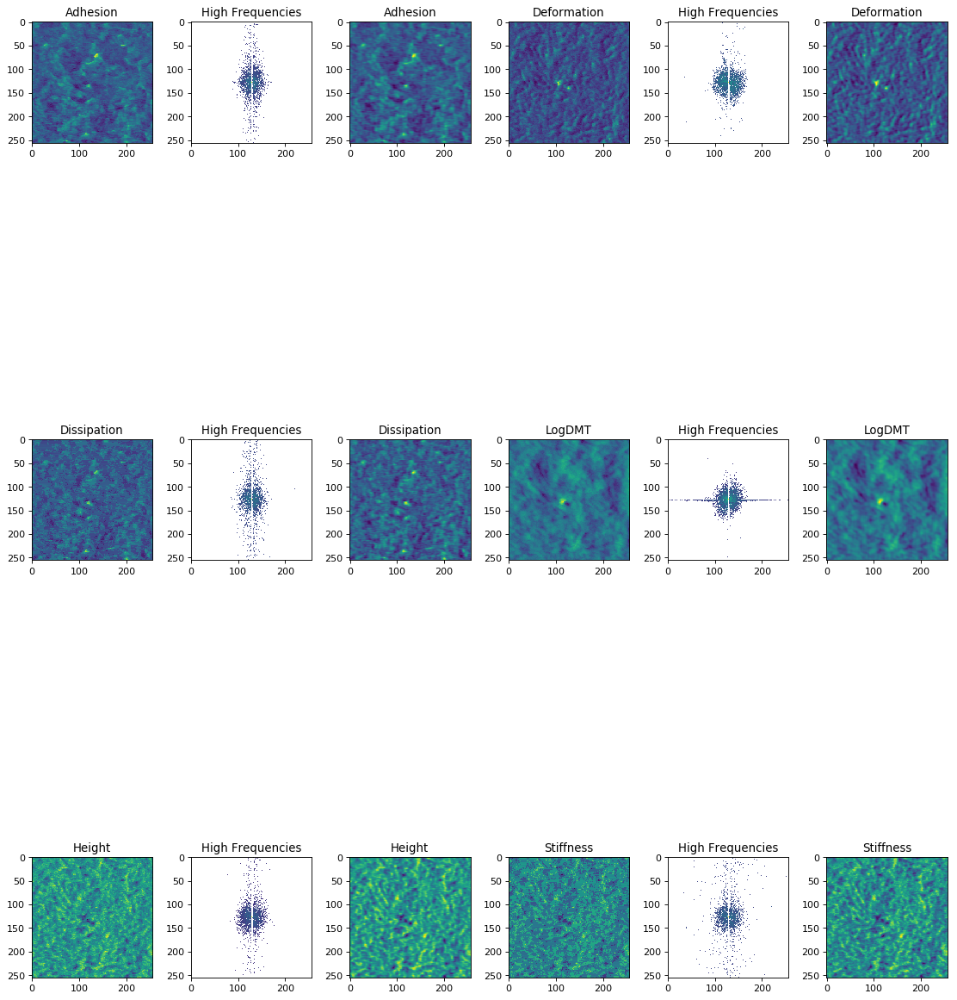

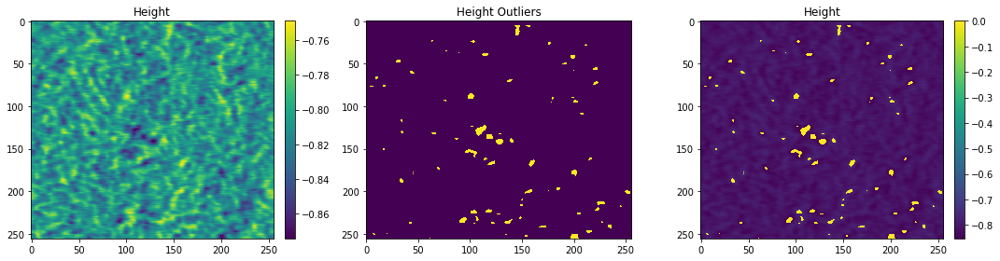

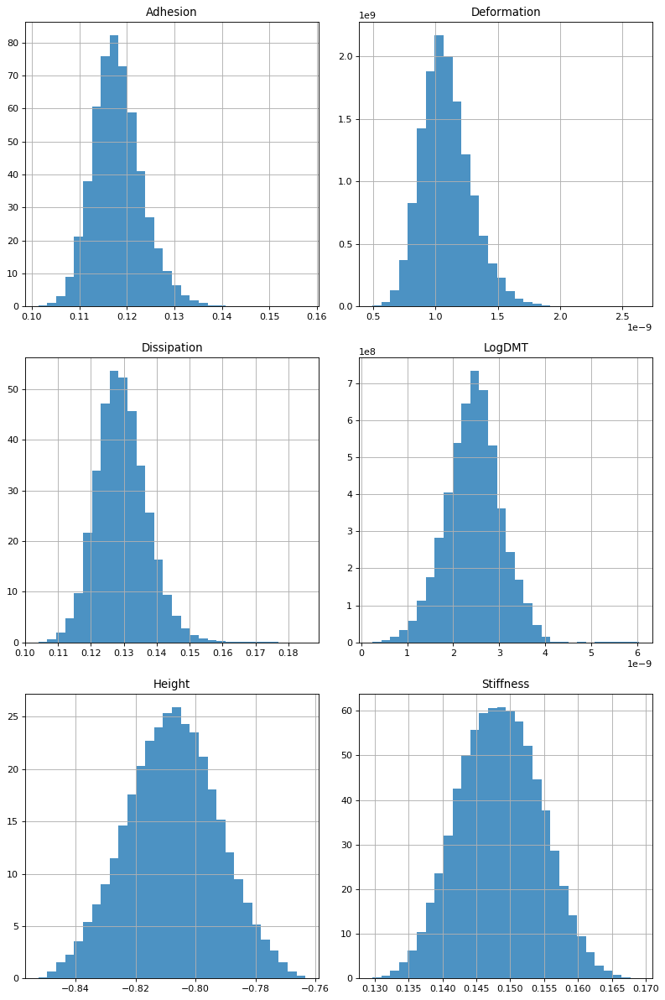

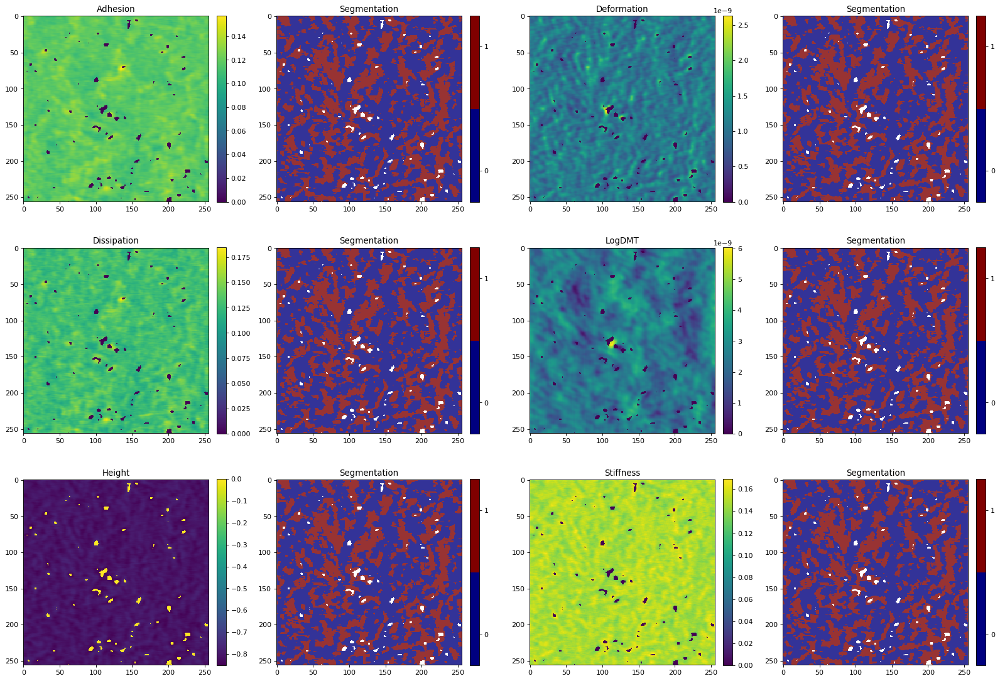

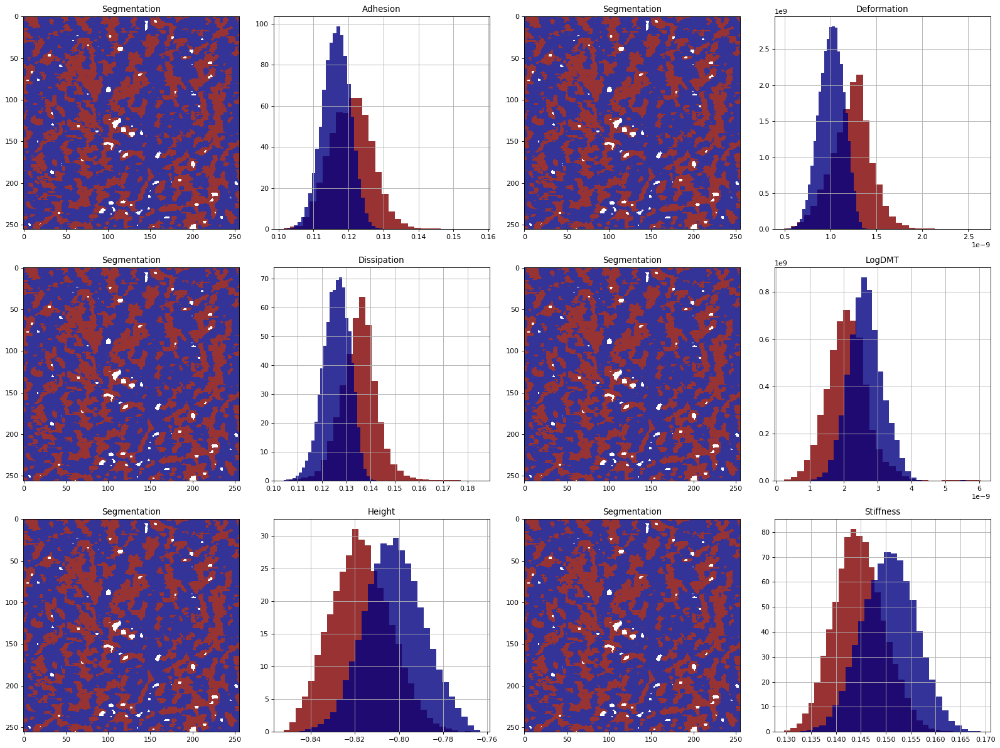

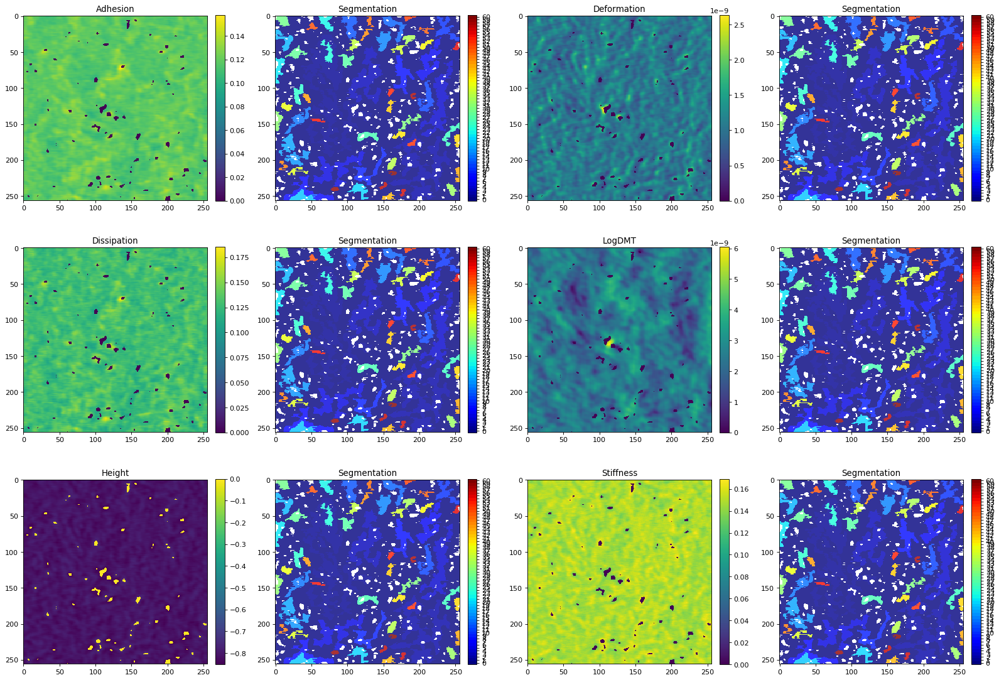

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


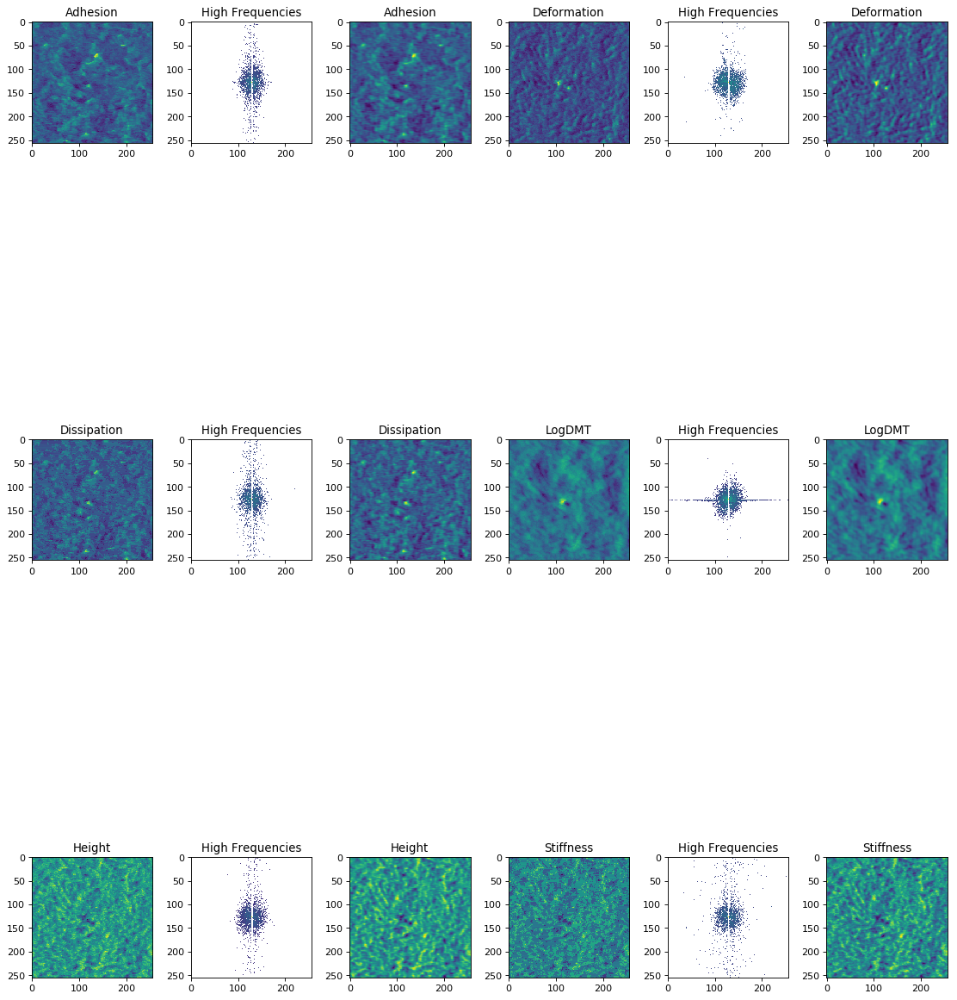

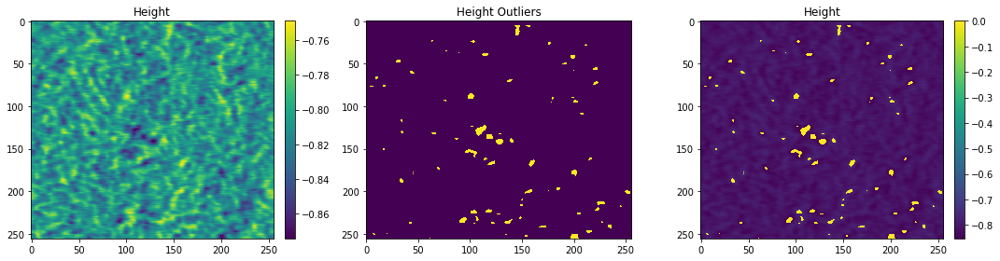

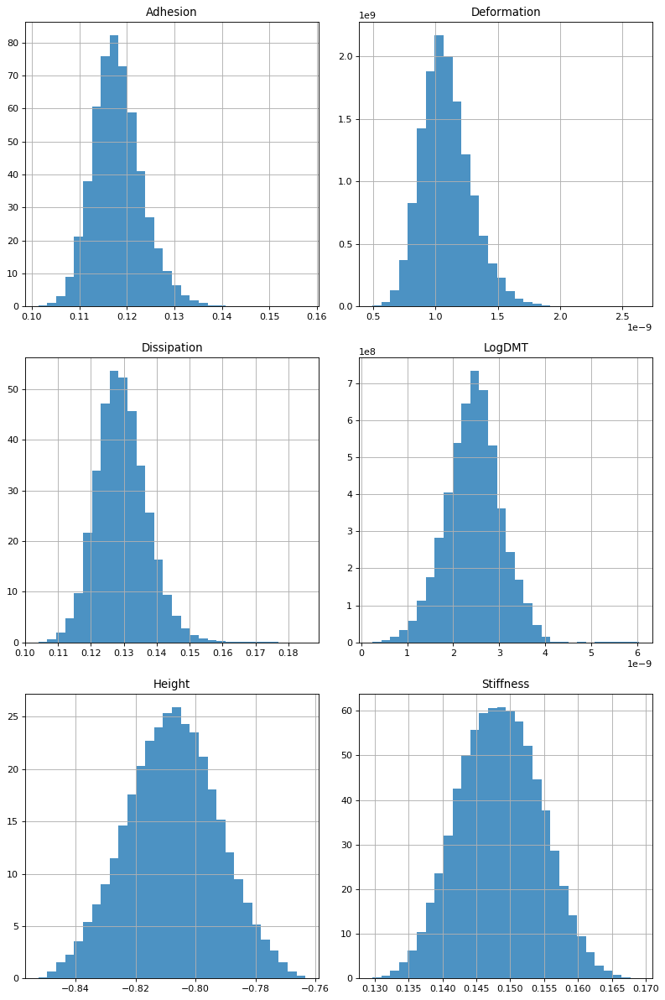

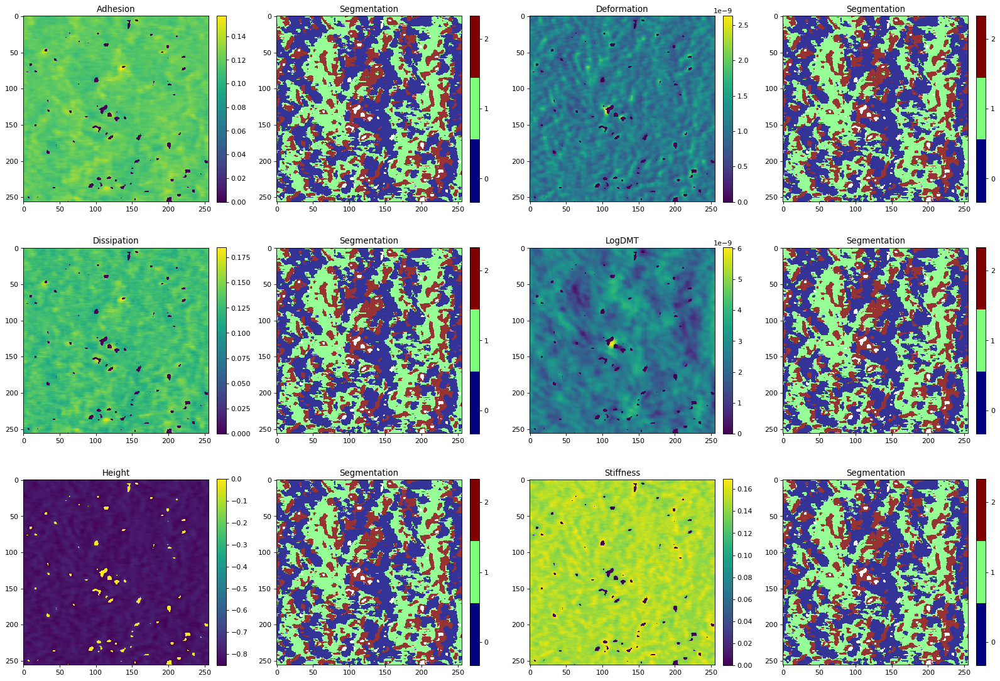

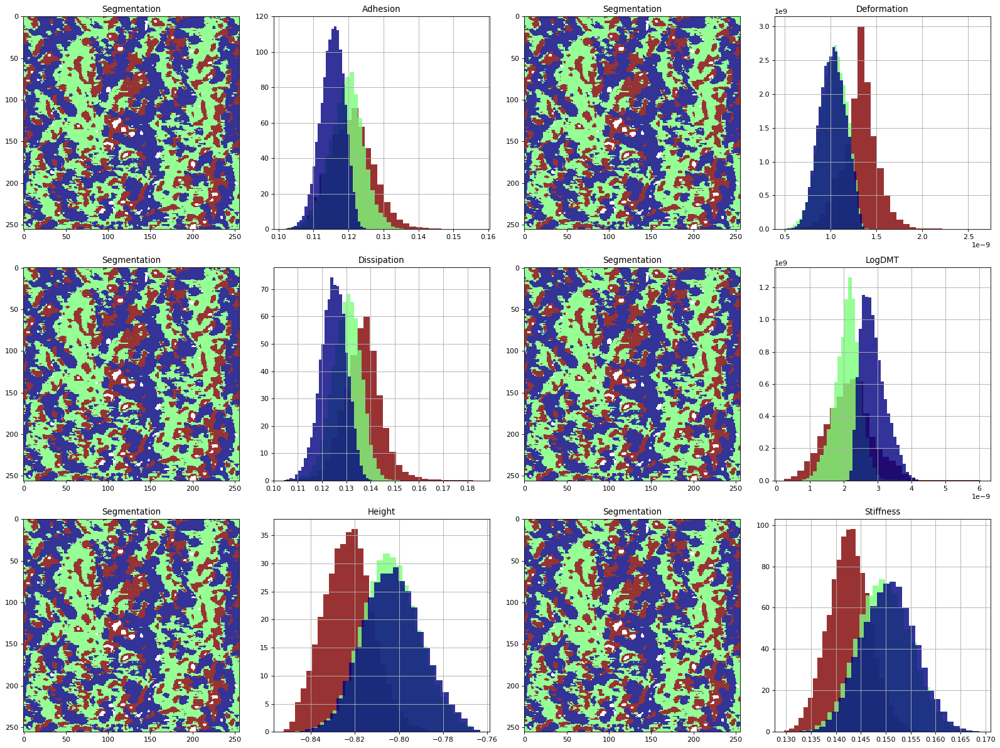

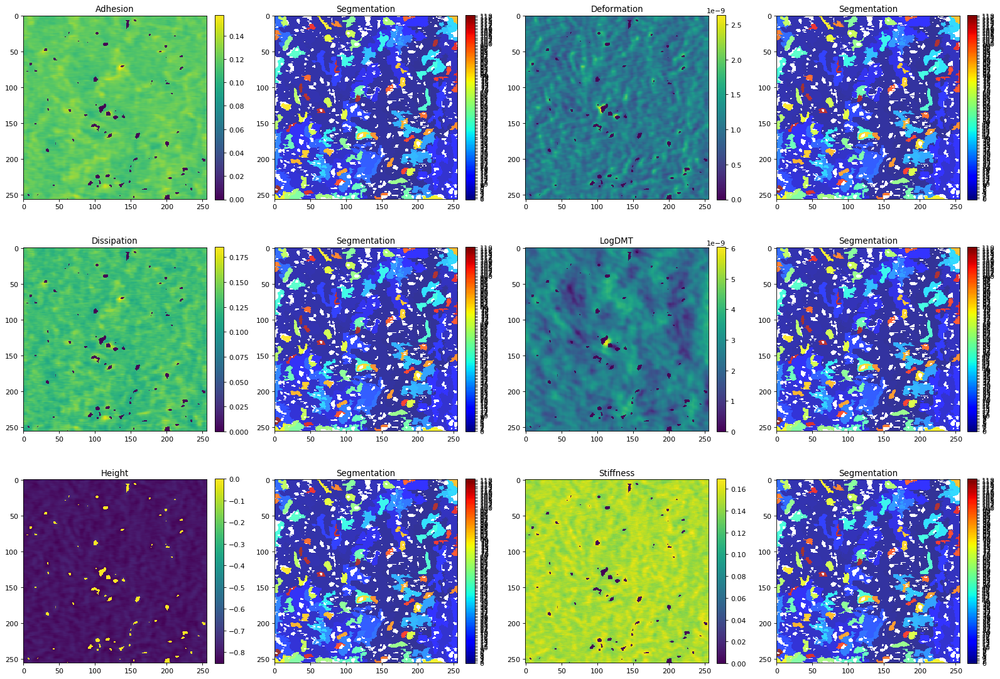

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


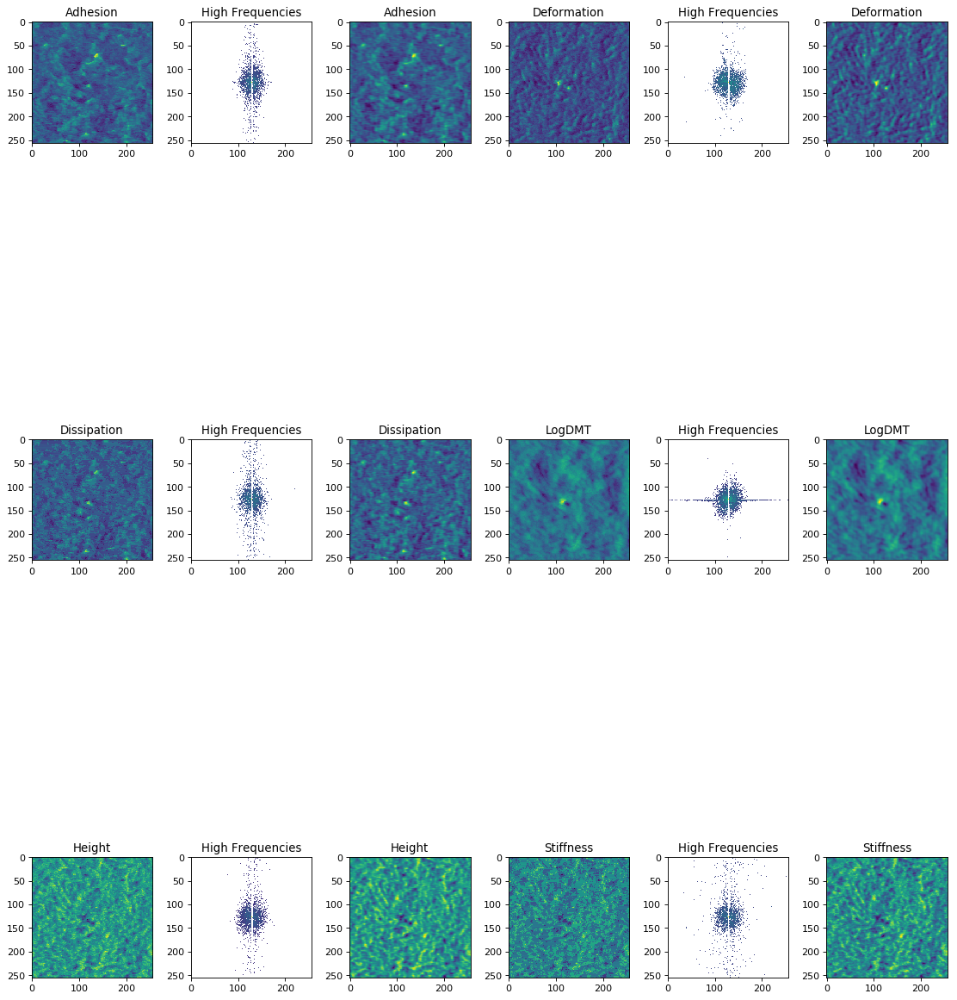

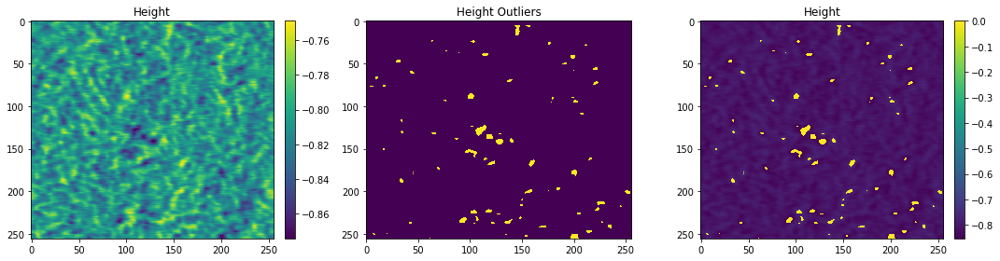

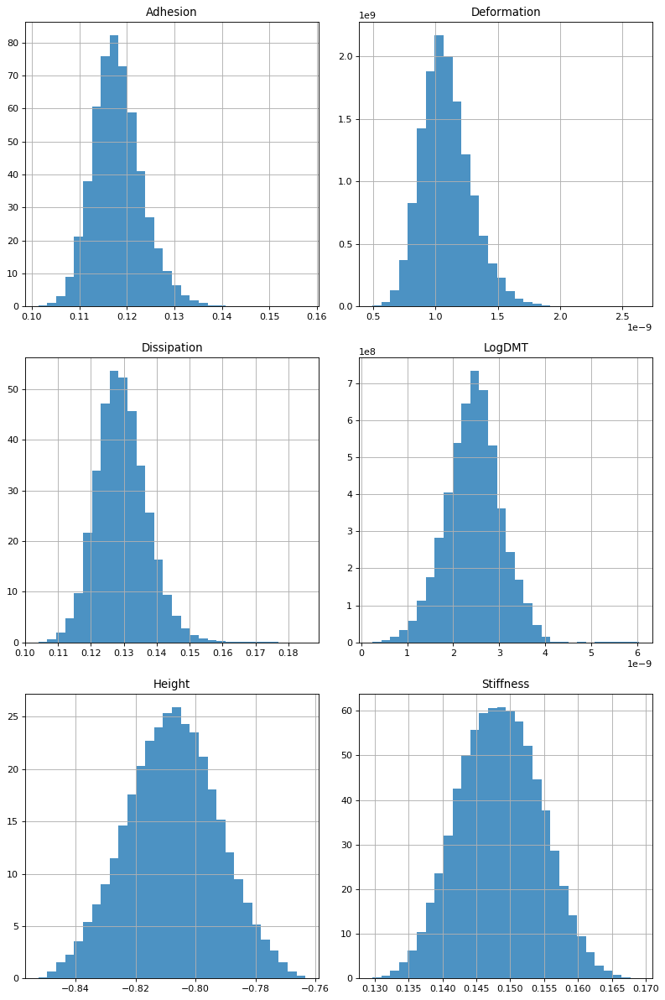

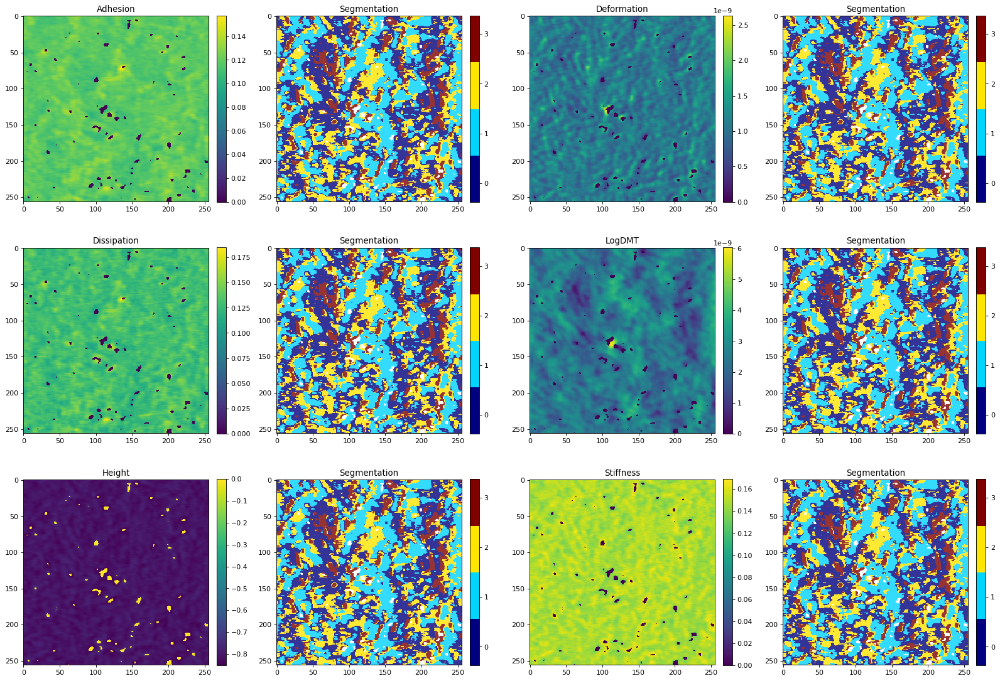

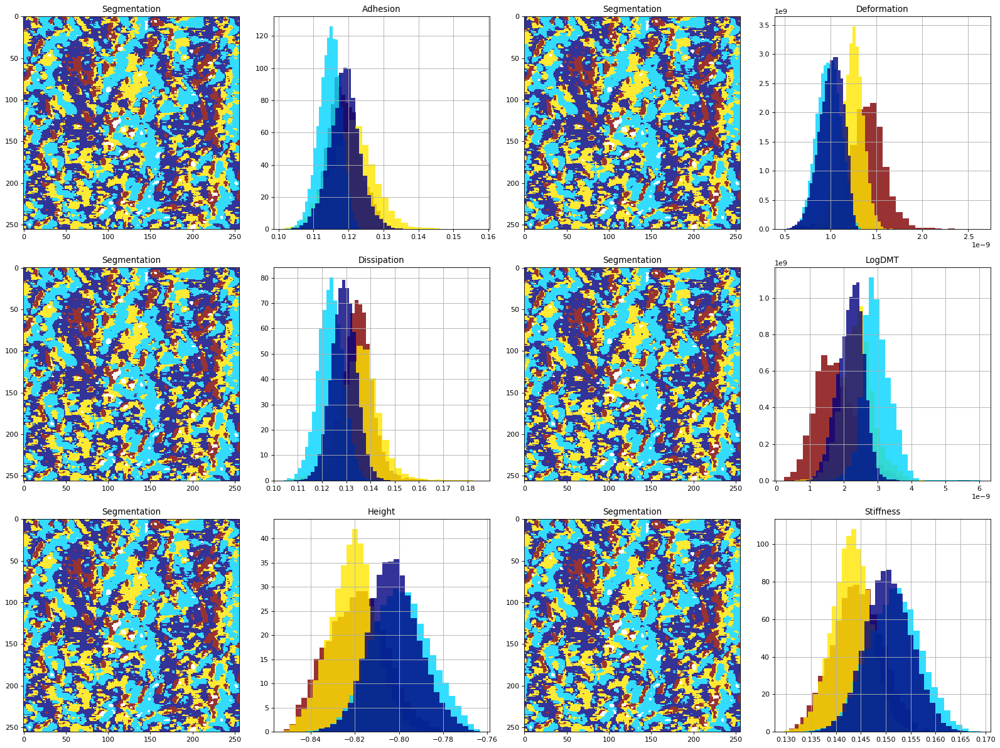

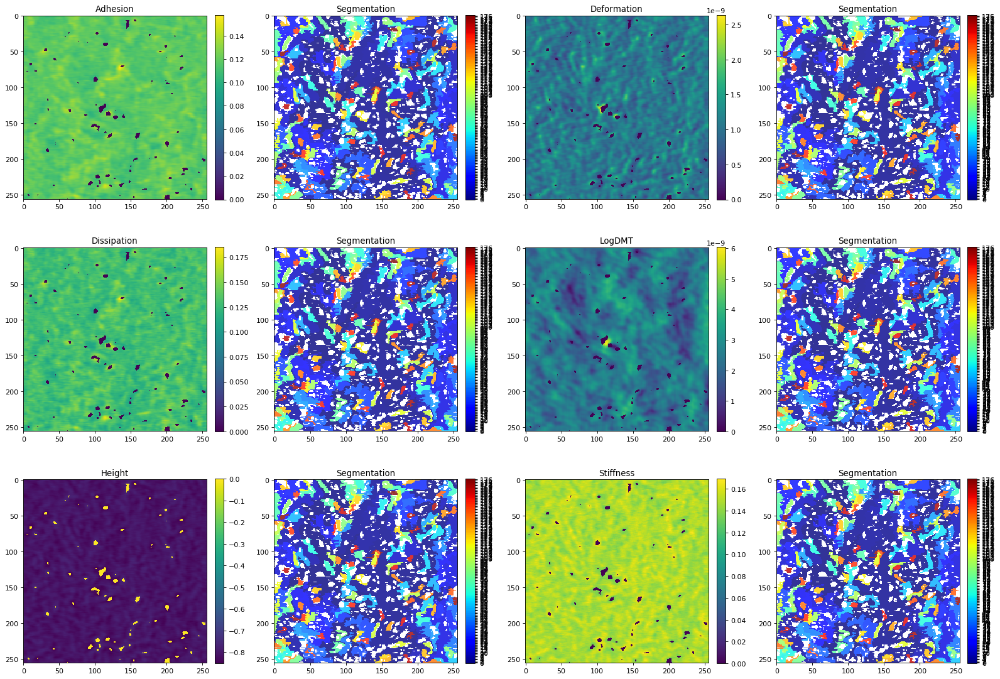

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


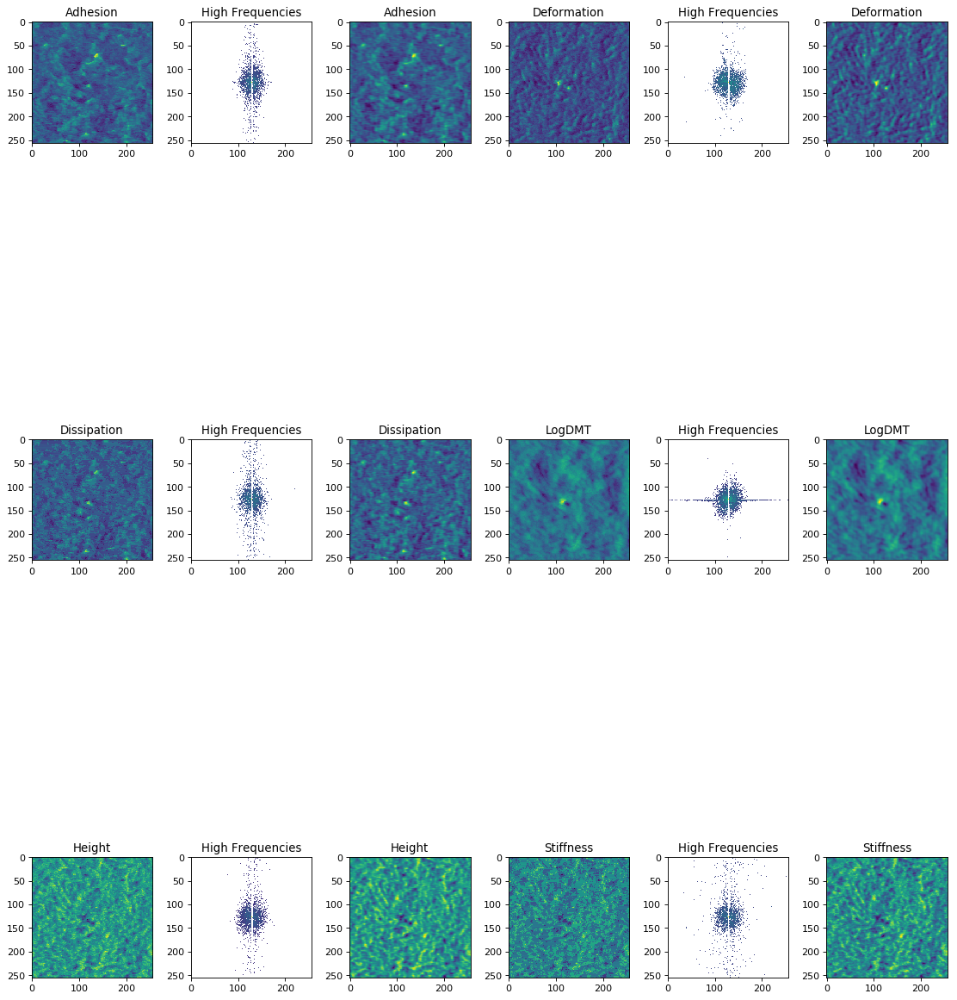

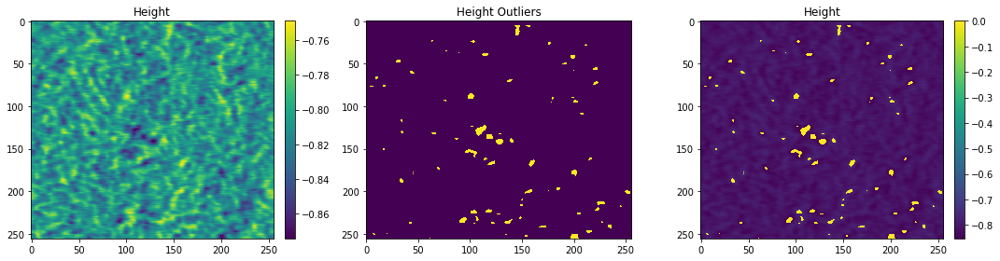

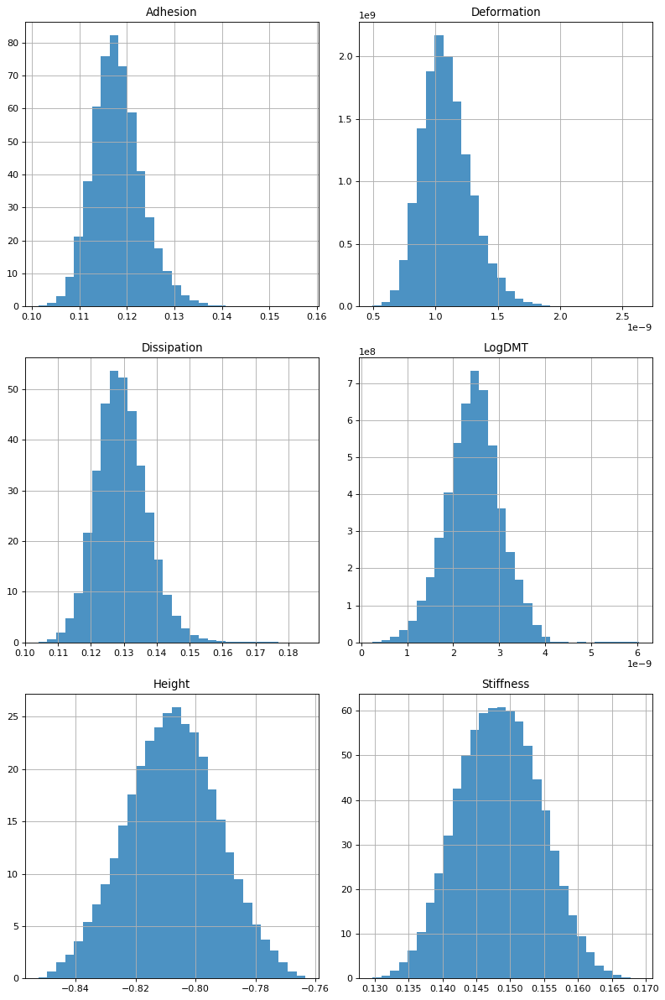

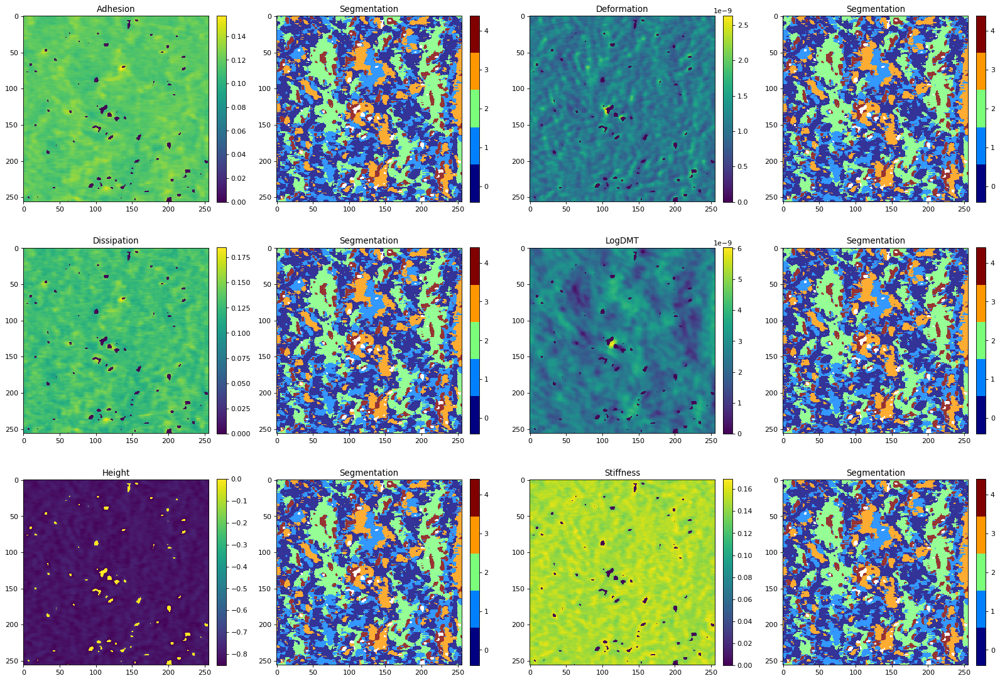

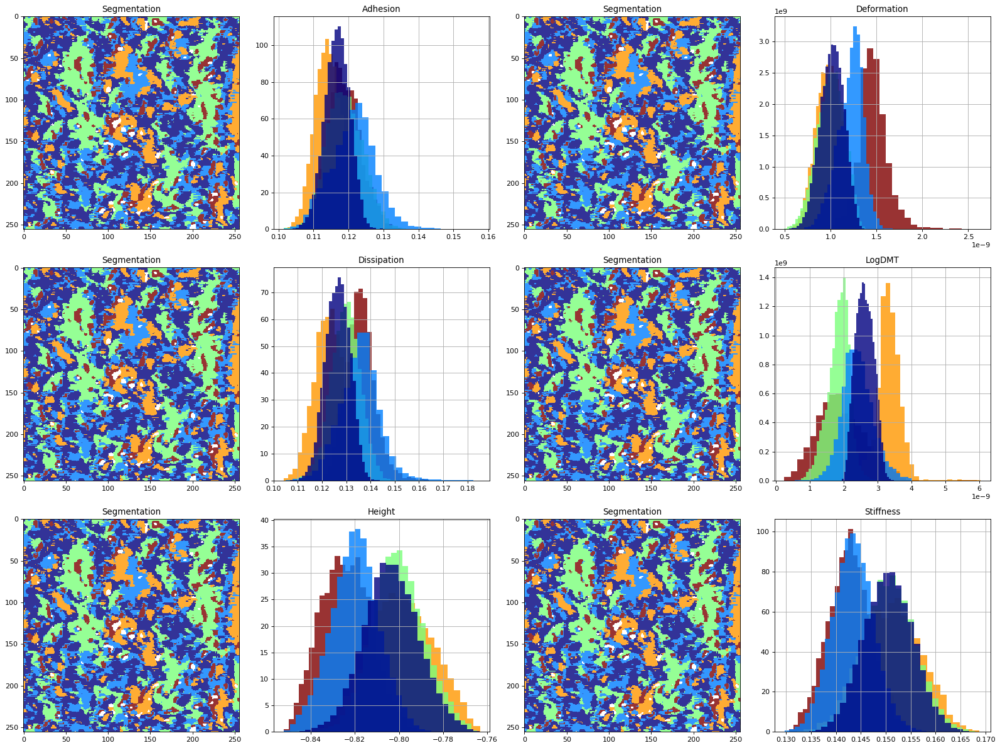

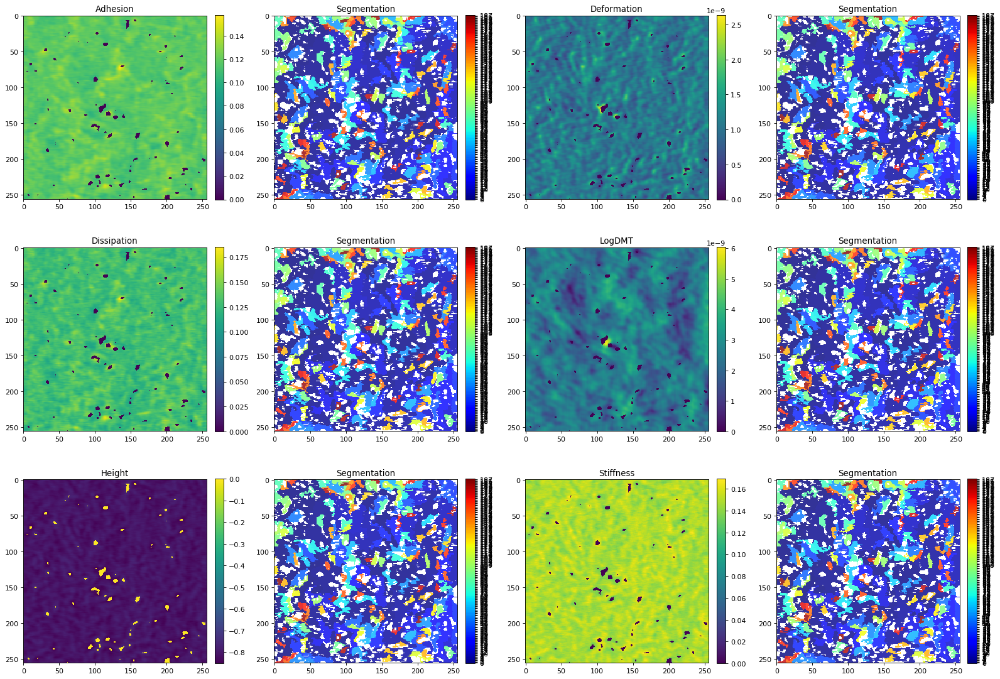

/anaconda3/lib/python3.7/site-packages/scipy/fftpack/basic.py:160: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  z[index] = x


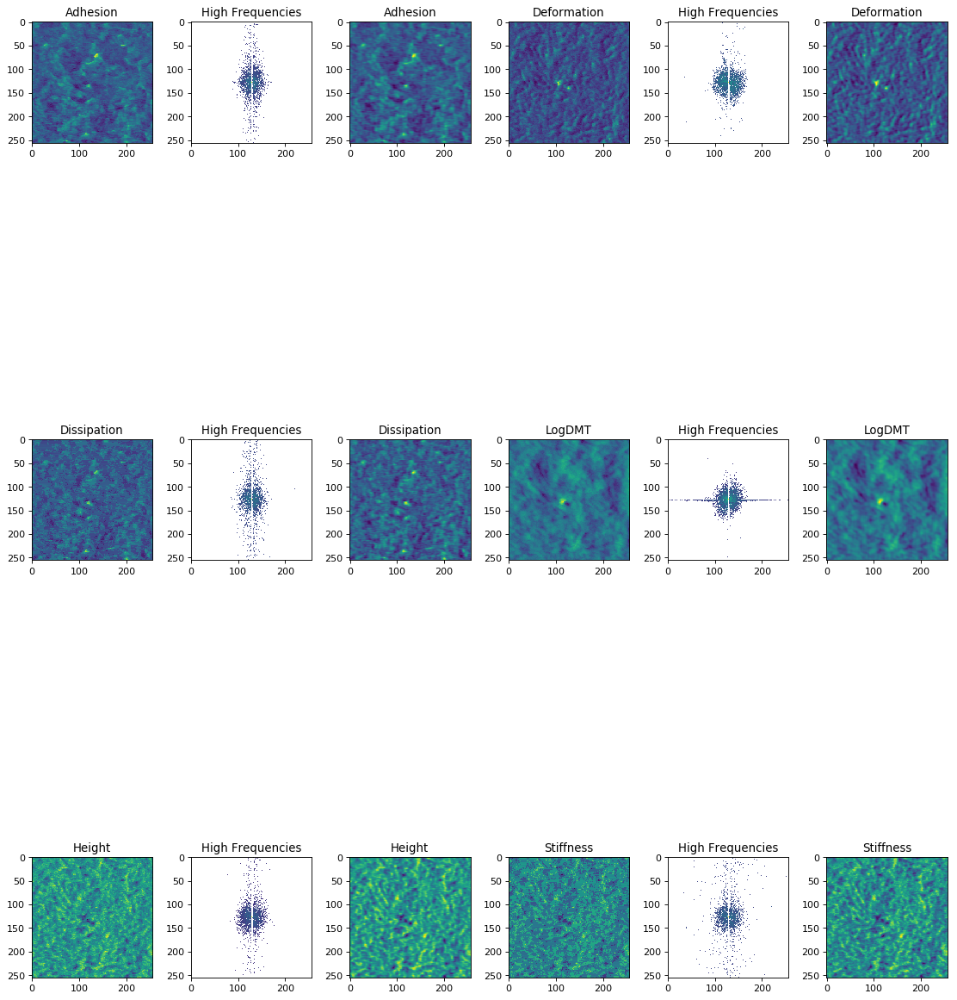

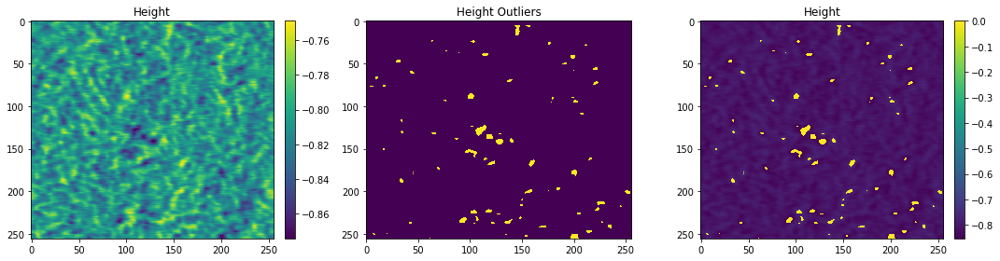

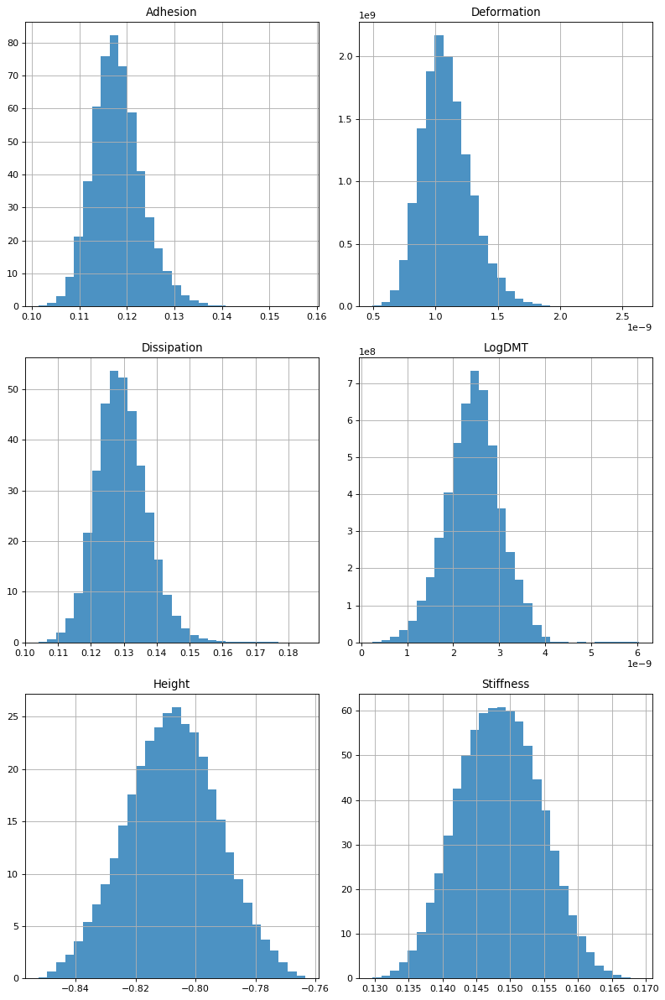

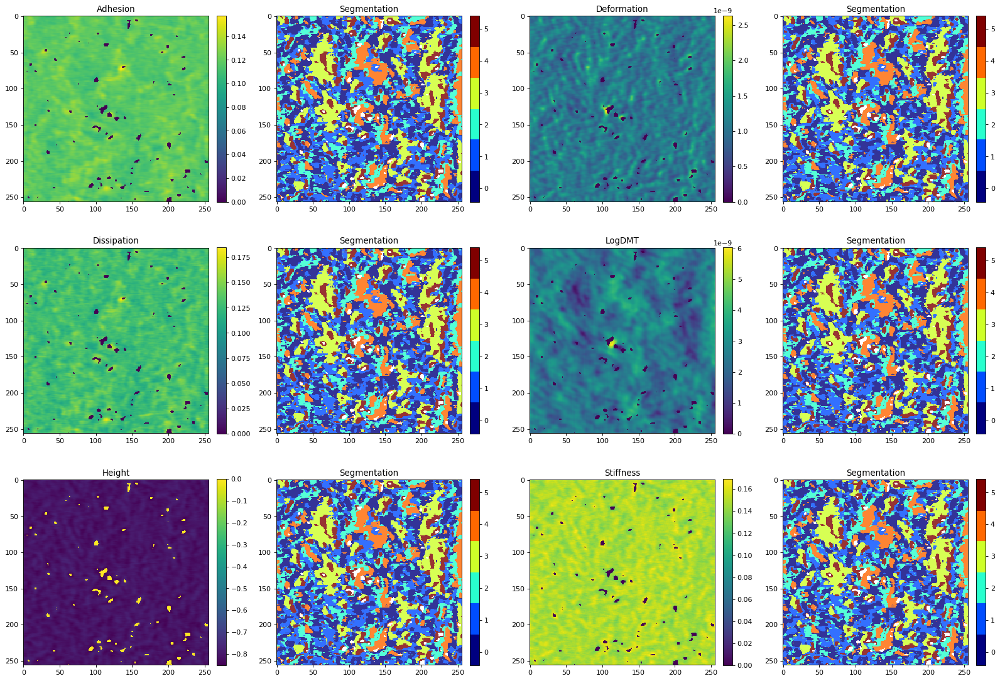

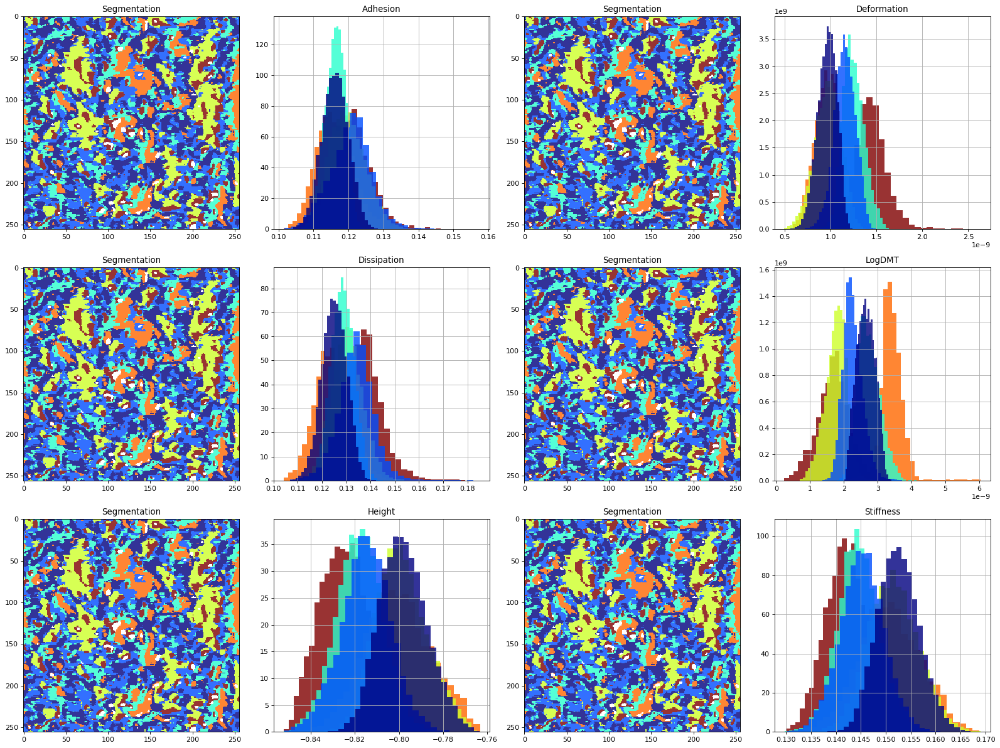

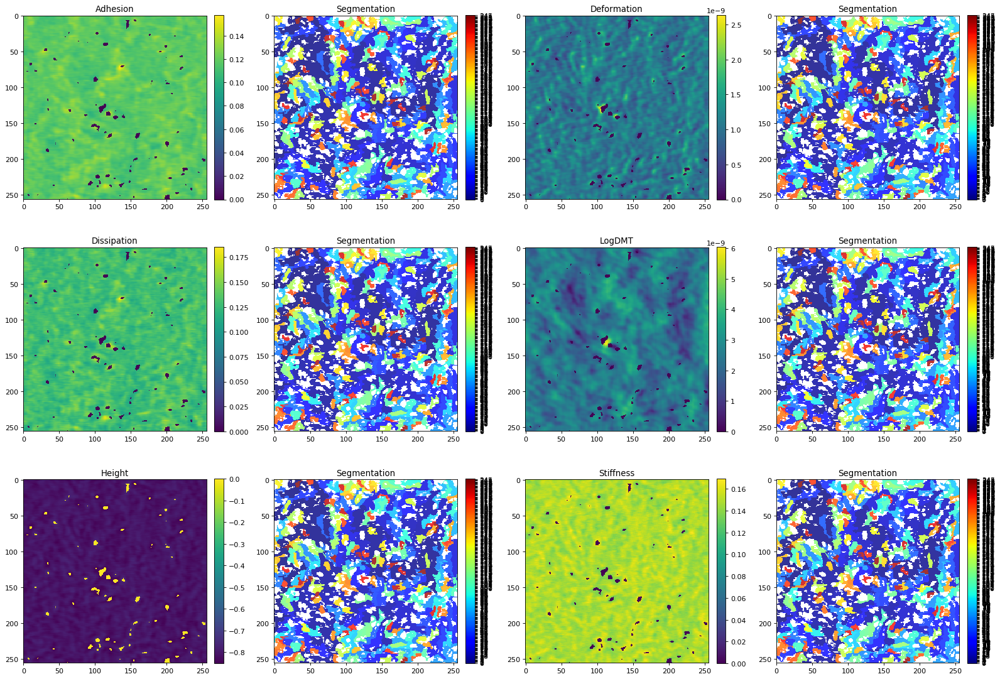

In [7]:
im = ims[2]

components = [1, 2, 3, 4, 5, 6]

heightless = False
padding = 0
embedding_dim = None
nonlinear = False
plots = True

p_stats = {}
# {num_components: {component: {property: stats}}}


for i in components:
    outliers, seg1_labels, seg2_labels = ssts_pipeline(im, heightless = heightless, n_components = i,
                                                   padding = padding, embedding_dim = embedding_dim,
                                                   nonlinear = nonlinear, plots = plots)
    
    p_stats[i] = get_stats_dict(seg1_labels, im)
    

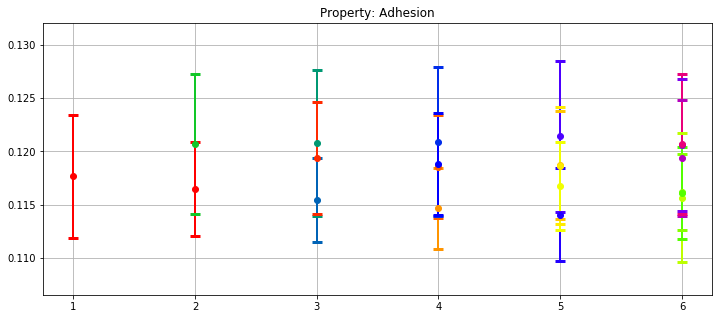

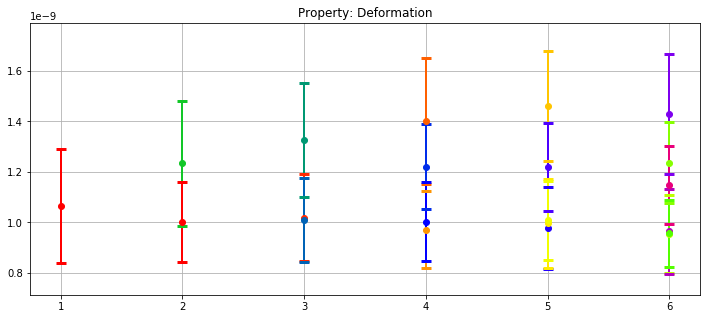

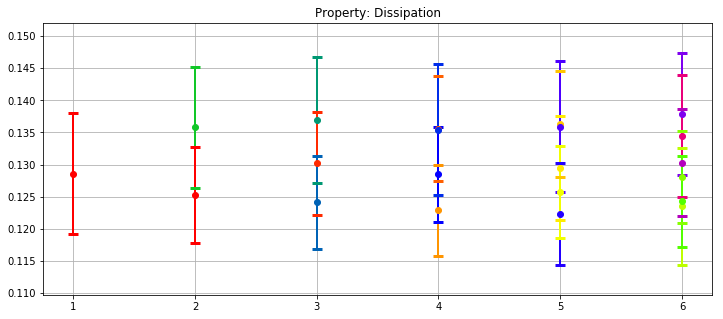

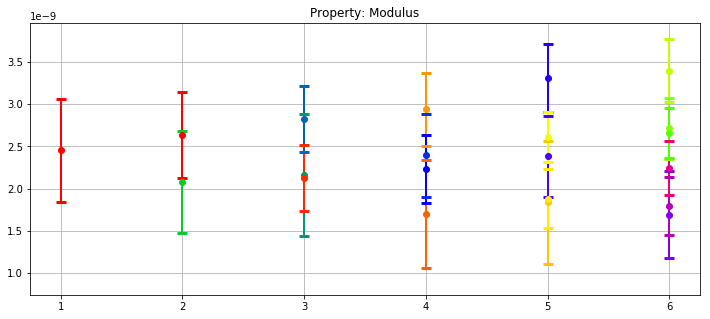

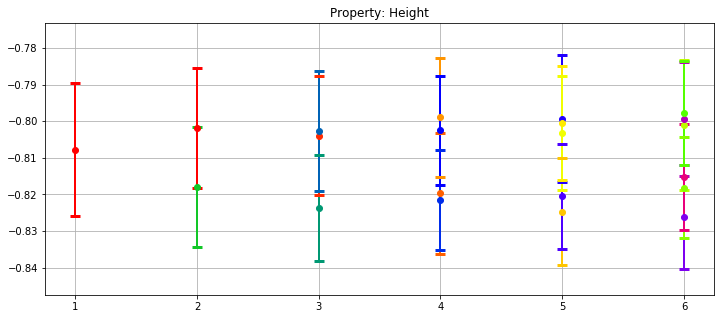

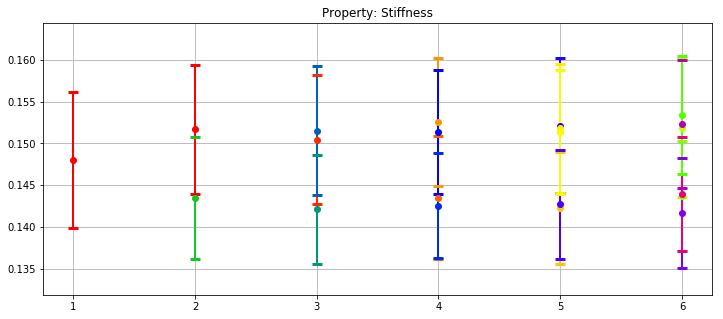

In [18]:


from random import shuffle

# Gather plotting points per property
data_plots = defaultdict(list)
for num_components, nc_dict in p_stats.items():
    for component, c_dict in nc_dict.items():
        for prop, stats in c_dict.items():
            median, std, var = stats    
            data_plots[prop].append([num_components, median, std])

            
# Complex Plot
for prop, tups in data_plots.items():
    plt.figure(figsize=(12,5))
    plt.title(f"Property: {qnm_fields[prop]}")
    
    # Shuffle is purely aesthetic. It's used to randomize the data points to be plotted. 
    # If shuffle is taken out (try this out), the colors in the plot will resemble the cmap (gist_ncar) sequence. 
    # With shuffle in, the colors used in plotting are more random, i.e., easier to distinguish from neighbors.
#     shuffle(tups)
    
    x_data, y_data, e_data = zip(*tups)
    
    cmap = plt.cm.get_cmap("prism", len(x_data))
    colors = [cmap(i) for i in range(len(x_data))]

    for (x, y, e), color in zip(tups, colors):
        plt.errorbar(x, y, yerr=e, color=color, fmt='o', ecolor=color, elinewidth=2, capsize=5, capthick=3)

    plt.ylim(min(np.array(y_data) - 1.5 * np.array(e_data)) , max(np.array(y_data) + 1.5 * np.array(e_data)))
    plt.grid()
    plt.show()
    
     

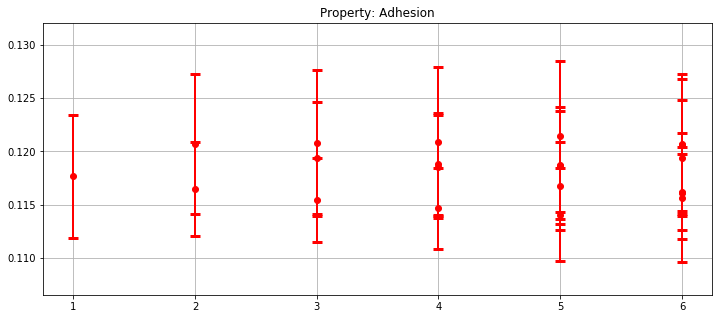

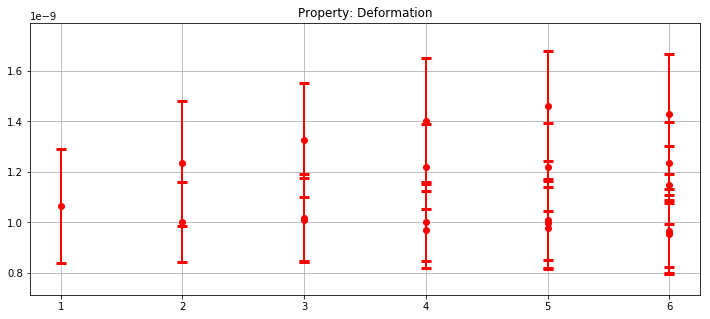

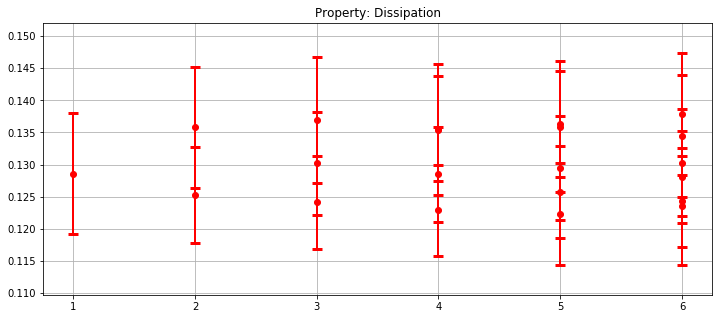

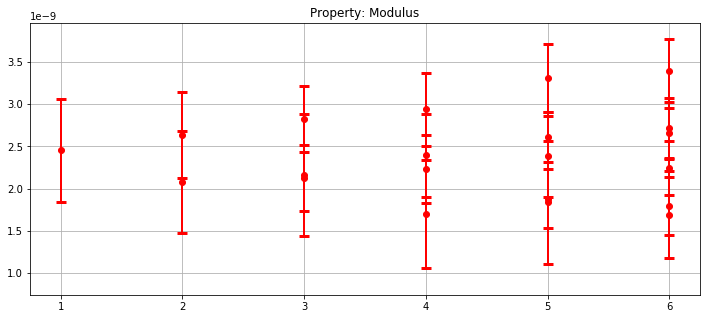

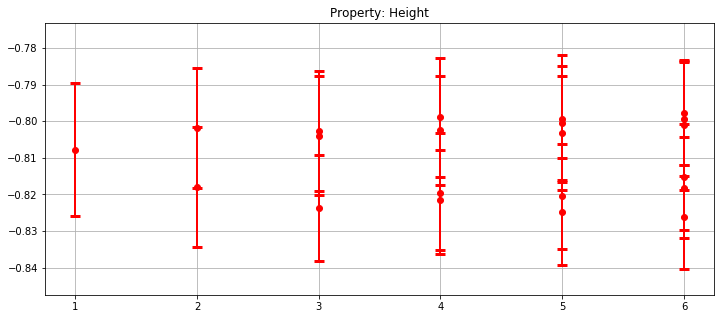

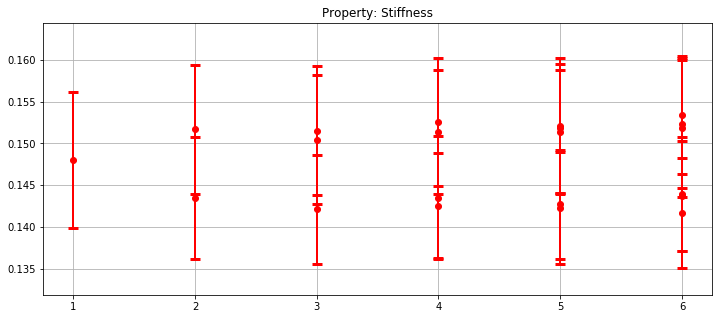

In [19]:
# Simple Plot

for prop, tups in data_plots.items():
    plt.figure(figsize=(12,5))
    plt.title(f"Property: {qnm_fields[prop]}")

    x_data, y_data, e_data = zip(*tups)
    
    plt.errorbar(x_data, y_data, yerr=e_data, color='r', fmt='o', ecolor='r', 
                    elinewidth=2, capsize=5, capthick=3)

    # I adjust the y limits so the error bars lie within the plot.
    plt.ylim(min(np.array(y_data) - 1.5 * np.array(e_data)) , max(np.array(y_data) + 1.5 * np.array(e_data)))
    plt.grid()
    plt.show()